In [2]:
import pydicom
import os
import matplotlib.pyplot as plt 
from PIL import Image, ImageDraw
import pandas as pd
import numpy as np
import cv2

%matplotlib inline

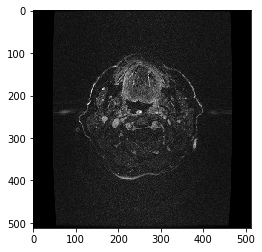

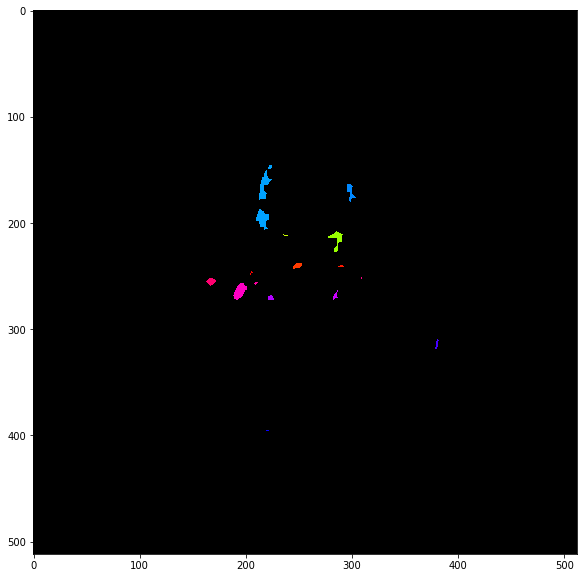

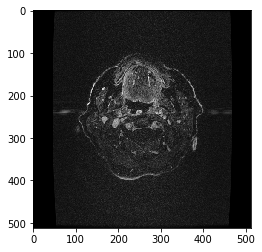

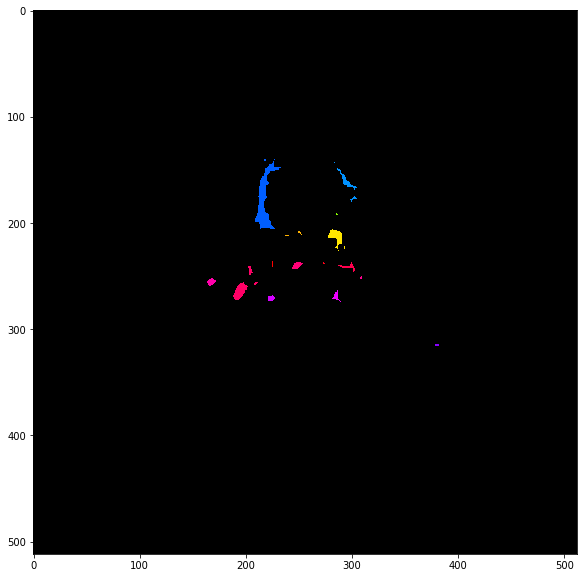

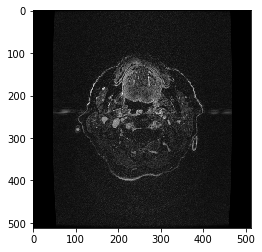

...

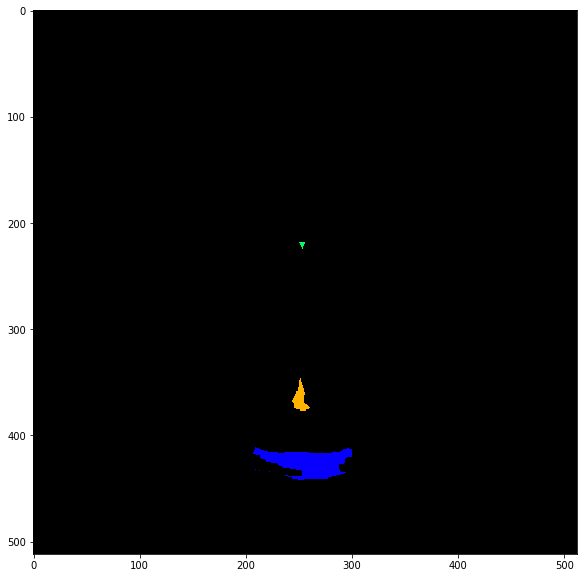

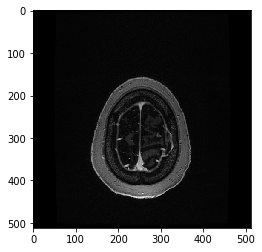

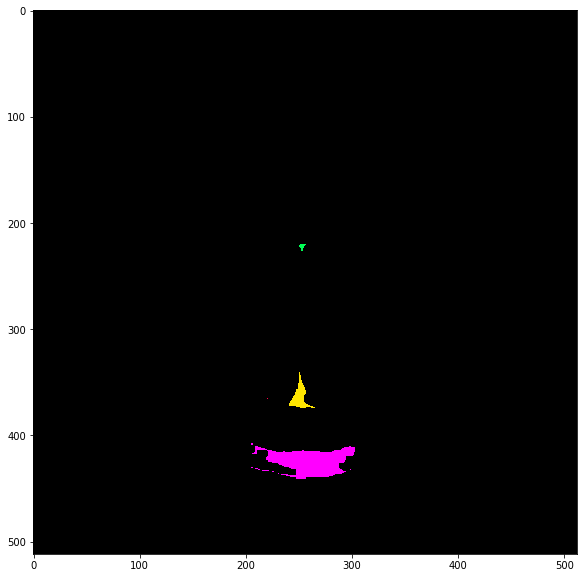

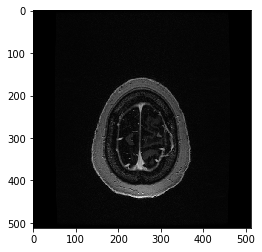

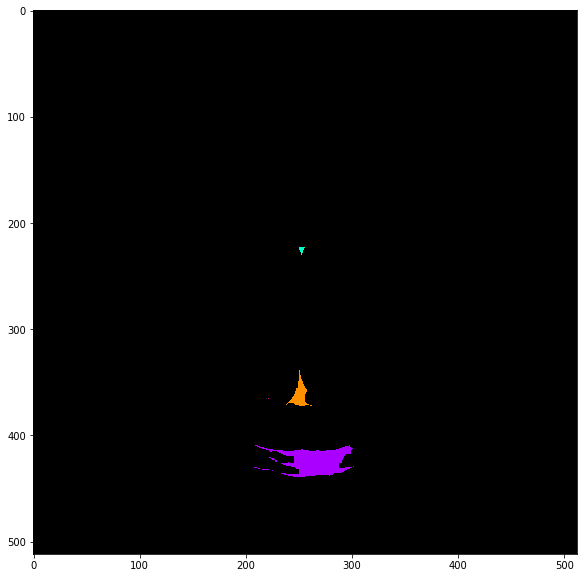

In [240]:
number_of_data = '361113'
scan_type = 'MR'
PATH_TO_FOLDER = "{}/".format(number_of_data)

frames_data = []
for i in range(1,300):
    try:
        _path_to_file = PATH_TO_FOLDER + "{}.{}.Image {}.dcm".format(scan_type, number_of_data, i)
        ds = pydicom.dcmread(_path_to_file)
        ds.pixel_array
        raw_img = ds.pixel_array
        img = (raw_img*(255./raw_img.max())).astype('uint8')
        plt.imshow(raw_img,cmap='gray')
        plt.show()
        img = process_image(img.copy())
        plt.figure(figsize=(20,10))
        plt.imshow(img)
        plt.show()
        #plt.imshow(abs(cv2.flip(img[::,256::], 1) - img[::,:256:]),cmap='gray')
        #plt.show()
    except OSError as e:
        pass

In [207]:
def process_image(img):
    img = raw_img*(255./raw_img.max())
    
    plt.imshow(img, cmap='gray')
    plt.show()
    ret, thresh = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
    plt.imshow(thresh)
    plt.show()

    #can = cv2.Canny(thresh, 100, 100)
    kernel = np.ones((4,4), np.uint8)
    #img_erosion = cv2.erode(thresh, kernel, iterations=1)
    #img_dilation = cv2.dilate(thresh, kernel, iterations=1)

    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, np.ones((4,4), np.uint8))
    thresh = abs(cv2.flip(thresh[::,256::], 1) - thresh[::,:256:])
    plt.imshow(thresh)
    plt.show()
    #thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, np.ones((5,5), np.uint8))
    #thresh = cv2.erode(thresh, kernel, iterations=1)
    #thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, np.ones((5,5), np.uint8))
    return thresh

In [239]:
def process_image(img_gray):
    blurred = cv2.GaussianBlur(img_gray, (7, 7), 0)
    #blurred = abs(cv2.flip(blurred[::,256::], 1) - blurred[::,:256:])
    ret, thresh = cv2.threshold(blurred, 100, 255, 0)
    #thresh = abs(cv2.flip(thresh[::,256::], 1) - thresh[::,:256:])
    ret, labels = cv2.connectedComponents(thresh)

    # Map component labels to hue val
    label_hue = np.uint8(179*labels/np.max(labels))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # cvt to BGR for display
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # set bg label to black
    labeled_img[label_hue==0] = 0

    labeled_img = cv2.erode(labeled_img, np.ones((3,3), np.uint8), iterations=2)
#     labeled_img = cv2.dilate(labeled_img, None, iterations=4)
    return labeled_img

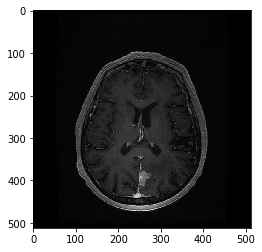

In [225]:
ds = pydicom.dcmread('361113/MR.361113.Image 195.dcm')
plt.imshow(ds.pixel_array,cmap='gray')
raw_img = ds.pixel_array
img_gray = (raw_img*(255./raw_img.max())).astype('uint8')
img_rgb = cv2.cvtColor(img_gray,cv2.COLOR_GRAY2RGB)
cv2.imwrite('img_gray.jpg', img_gray)
plt.imshow(img_gray, cmap='gray')

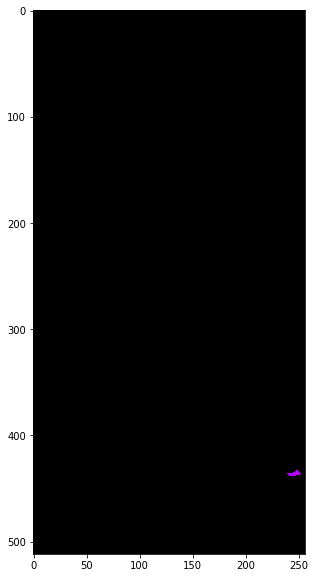

In [221]:
plt.figure(figsize=(20,10))
plt.imshow(process_image(img_gray),cmap='gray')

In [ ]:
plt.imshow(process_image(raw_img),cmap='gray')

In [230]:
(256 + 85) / 2

170.5

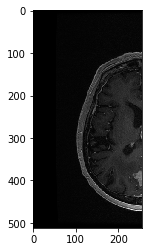

In [34]:
plt.imshow(cv2.flip(img[::,256::], 1), cmap='gray')

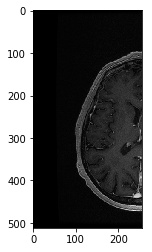

In [33]:
plt.imshow(img[::,:256:], cmap='gray')

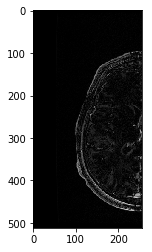

In [44]:
plt.imshow(abs(cv2.flip(img[::,256::], 1) - img[::,:256:]), cmap='gray')

In [42]:
abs(cv2.flip(img[::,256::], 1) - img[::,:256:]).min()

0.0

In [37]:
img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

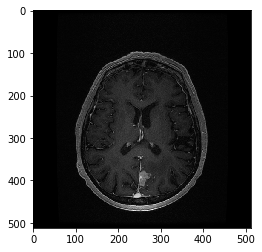

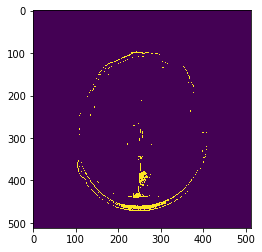

In [241]:
ret, thresh = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
plt.imshow(thresh)

In [285]:
can = cv2.Canny(thresh, 100, 100)
kernel = np.ones((4,4), np.uint8)
#img_erosion = cv2.erode(thresh, kernel, iterations=1)
img_dilation = cv2.dilate(thresh, kernel, iterations=1)
img_ex = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, np.ones((4,4), np.uint8))
img_op = cv2.morphologyEx(img_ex, cv2.MORPH_OPEN, np.ones((5,5), np.uint8))
img_op = cv2.erode(img_op, kernel, iterations=1)
img_op = cv2.morphologyEx(img_ex, cv2.MORPH_OPEN, np.ones((5,5), np.uint8))

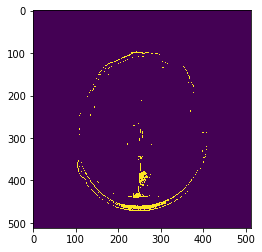

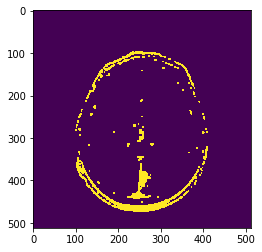

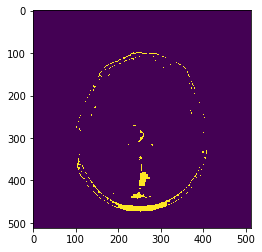

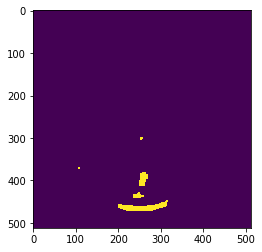

In [286]:
plt.imshow(thresh)
plt.show()
plt.imshow(img_dilation)
plt.show()
plt.imshow(img_ex)
plt.show()
plt.imshow(img_op)
plt.show()

In [71]:
thresh.shape

(512, 512)

In [77]:
img.shape

(512, 512)

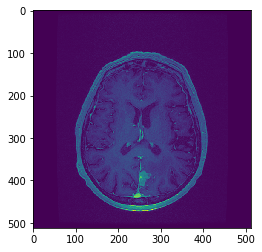

In [79]:
plt.imshow(img)

In [86]:
img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [139]:
thresh

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

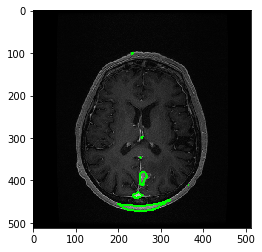

In [180]:
#img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY);
blurred = cv2.GaussianBlur(img_gray, (11, 11), 0)
ret, thresh = cv2.threshold(blurred, 100, 255, 0)
im2, contours, hierarchy = cv2.findContours(thresh, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

plt.imshow(cv2.drawContours(img_rgb.copy(), contours, -1, (0,255,0), 3))

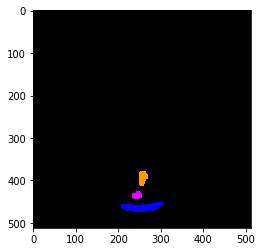

In [216]:
ret, labels = cv2.connectedComponents(thresh)

# Map component labels to hue val
label_hue = np.uint8(179*labels/np.max(labels))
blank_ch = 255*np.ones_like(label_hue)
labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

# cvt to BGR for display
labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

# set bg label to black
labeled_img[label_hue==0] = 0

labeled_img = cv2.erode(labeled_img, None, iterations=2)
labeled_img = cv2.dilate(labeled_img, None, iterations=4)
plt.imshow(labeled_img)

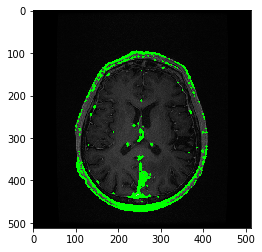

In [156]:
plt.imshow(img_rgb)

In [75]:
ret, thresh = cv2.threshold(img, 100, 255, 0)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
#cv2.drawContours(img, contours, -1, (0,255,0), 3)

AttributeError: 'numpy.ndarray' object has no attribute 'convertTo'

In [228]:
#img = cv2.medianBlur(img, 5)
#ret, thresh = cv2.threshold(img_dilation,100,255,cv2.THRESH_BINARY)

In [229]:
#plt.imshow(thresh)

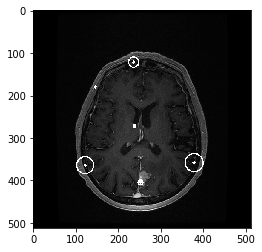

In [274]:
cirk = img.copy()
circles = cv2.HoughCircles(img_dilation,cv2.HOUGH_GRADIENT,1,100, param1=100,param2=10,minRadius=0,maxRadius=30)

circles = np.uint16(np.around(circles))

for i in circles[0,:]:
   # draw the outer circle
   cv2.circle(cirk,(i[0],i[1]),i[2],(255,255,255),2)
   # draw the center of the circle
   cv2.circle(cirk,(i[0],i[1]),2,(255,255,255),3)

plt.imshow(cirk, cmap='gray')

In [71]:
img = cv2.medianBlur(img, 5)
#cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)

circles = cv2.HoughCircles(img,cv2.HOUGH_GRADIENT,1,120, param1=100,param2=30,minRadius=0,maxRadius=0)

circles = np.uint16(np.around(circles))

for i in circles[0,:]:
   # draw the outer circle
   cv2.circle(img,(i[0],i[1]),i[2],(255,255,255),2)
   # draw the center of the circle
   cv2.circle(img,(i[0],i[1]),2,(255,255,255),3)

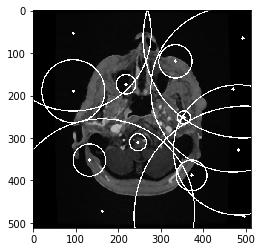

In [72]:
plt.imshow(img, cmap='gray')

In [9]:
number_of_data = '361113'
scan_type = 'MR'
meta_data_file = "RS.361113.MR_0809.dcm".format(number_of_data)
PATH_TO_FOLDER = "{}/".format(number_of_data)

frames_data = []
for i in range(1,300):
    try:
        _path_to_file = PATH_TO_FOLDER + "{}.{}.Image {}.dcm".format(scan_type, number_of_data, i)
        ds = pydicom.dcmread(_path_to_file)

        frames_data.append(
            {
                "frame": ds.pixel_array,
                "z_index": ds.ImagePositionPatient[2],
                "image_position_xy": ds.ImagePositionPatient[0:2],
                "Time": ds.StudyDate,
            }
        )
    except OSError as e:
        pass

slices_df = pd.DataFrame(frames_data)

meta_ds = pydicom.dcmread(PATH_TO_FOLDER + meta_data_file)
for tumors in meta_ds.ROIContourSequence:
    print('new trumor!')
    for tumor in tumors.ContourSequence:
        cancer_poly = tumor.ContourData
        z = cancer_poly[2]
        print(z)
        frames = slices_df[(slices_df['z_index'] >= z - 0.999) & (slices_df['z_index'] <= z + 0.999)]
        print("Found {} images".format(len(frames)))
        img = frames.iloc[0].frame
        coords_shift = frames.iloc[0].image_position_xy
        plt.imshow(img,cmap='gray')
        plt.show()
        poly = list(zip(cancer_poly[0::3], cancer_poly[1::3]))
        

        
        brain_image = Image.fromarray(img).point(lambda i:i*(1./256)).convert('L').convert('RGBA')
        
        poly = [((int(i[0]) - coords_shift[0]), (int(i[1]) - coords_shift[1])) for i in poly]
        print(poly)
        #plt.imshow(brain_image,cmap='gray')
        #plt.show()
        img2 = brain_image.copy()
        draw = ImageDraw.Draw(img2)
        draw.polygon(poly, fill = "red")
        
        img3 = Image.blend(brain_image, img2, 0.5)
        plt.figure(figsize=(10,10))
        plt.imshow(img3)
        plt.show()

ValueError: The length of the pixel data in the dataset doesn't match the expected amount (113152 vs. 524288 bytes). The dataset may be corrupted or there may be an issue with the pixel data handler.